In [1]:
# importing packages
import numpy as np
import pandas as pd
import dateutil
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import geopandas as gpd
import spacy
import re
import descartes

In [15]:
# Praparing the the searchterm lemmas 
# Writing Spacy Lemmatizer for lists function
def spacy_list_lemmatizer(text, nlp):
    nlp.disable_pipes('tagger', 'ner')
    doclist = list(nlp.pipe(text, n_threads=3,  batch_size=50))
    docs=[]
    for i, doc in enumerate(doclist):
        docs.append(' '.join([listitem.lemma_ for listitem in doc]))
    return docs


# creating the lemmas of all english co-searchterms
searchterms_eng = ['"agile" capability', '"agile" ceremony', '"agile" certificate', '"agile" certification', '"agile" coach', '"agile" coaching', '"agile" delivery', '"agile" development', '"agile" digital capability ', '"agile" environment', '"agile" innovation', '"agile" management', '"agile" manifesto', '"agile" method', '"agile" methodology', '"agile" mindset', '"agile" operating model', '"agile" organisation', '"agile" organization unit', '"agile" principle', '"agile" processes', '"agile" programming', '"agile" project', '"agile" project management', '"agile" software development', '"agile" stages', '"agile" structures', '"agile" team', '"agile" techniques', '"agile" transformation', '"agile" transition', '"agile" Value', '"agile" walls', '"agile" way', '"agile" way of working', '"agile" work', '"agile" work practices', '"agile" working and management methods', '"agile" working culture', "'agile' capability", "'agile' ceremony", "'agile' certificate", "'agile' certification", "'agile' coach", "'agile' coaching", "'agile' delivery", "'agile' development", "'agile' digital capability ", "'agile' environment", "'agile' innovation", "'agile' management", "'Agile' Manifesto", "'agile' method", "'agile' methodology", "'agile' mindset", "'agile' operating model", "'agile' organisation", "'agile' organization unit", "'agile' principle", "'agile' processes", "'agile' programming", "'agile' project", "'agile' project management", "'agile' software development", "'agile' stages", "'agile' structures", "'agile' team", "'agile' techniques", "'agile' transformation", "'agile' transition", "'agile' Value", "'agile' walls", "'agile' way", "'agile' way of working", "'agile' work", "'agile' work practices", "'agile' working and management methods", "'agile' working culture", "backlog", "co-design", "collaboration spaces", "collaborative design", "cross-departmental approach", "daily scrum", "definition of done", "definition of ready", "design thinking", "development team", "empathy map", "extreme user", "fail fast", "fail forward", "free of hierarchy", "hierarchy free space", "innovation culture", "innovation management", "iteration", "iterative", "kanban board", "lean software development", "lean start up", "lean start-up", "lean startup", "minimum viable product", "MVP", "new team and management structures", "new work", "new working methods", "planning poker", "product backlog", "product owner", "project canvas", "project-based", "scrum", "scrum coach", "scrum master", "scrum team", "service design", "short-cycle results", "software development", "sprint", "sprint backlog", "sprint planning", "sprint retrospective", "sprint review", "time box", "timeboxing", "user needs", "user requirements", "user research", "user story", "user testing", "user-centred design", "user-friendly solutions", "user-oriented", "visual thinking", "whiteboard", "wicked problem", "wireframe", "workshop"]

nlp_eng = spacy.load("en_core_web_sm")

searchterms_eng_lemma = spacy_list_lemmatizer(searchterms_eng, nlp_eng)

# creating the lemmas of all german co-searchterms
searchterms_de = ["abteilungsübergreifender Ansatz", "'agil' arbeitende Organisationseinheit", "'agil' arbeitende Teams", "'agile' Arbeitsformen", "'agile' arbeitskultur", "'agile' Arbeitspraktiken", "'agile' arbeitsumgebung", "'agile' Arbeitsweise", "'agile' Bereitstellung", "'agile' digitale Fähigkeit ", "'agile' Entwicklung", "'agile' Fähigkeiten ", "'agile' Innovation", "'agile' Methode", "'agile' Methodik", "'agile' Organisation", "'agile' Phasen", "'agile' Prozesse", "'agile' Softwareentwicklung", "'agile' Softwareweiterentwicklung", "'agile' Strukturen", "'agile' Techniken", "'agile' Transformation", "'agile' Transition", "'agile' Wände", "'agile' Weise", "'agile' Zeremonie", "'agile' Zertifizierung", "'agilen' Arbeits- und Managementmethoden", "'agiler' Ansatz", "'agiler' Coach", "'agiler' Wert", "'agiles' Arbeiten", "'agiles' Betriebsmodell", "'agiles' Coaching", "'agiles' Management", "'agiles' Manifest", "'agiles' Mindset", "'agiles' Prinzip", "'agiles' Programmieren", "'agiles' Projekt", "'agiles' Projektmanagement", "'agiles' Team", "'agiles' Training ", "'agiles' Zertifikat", '"agil" arbeitende Organisationseinheit', '"agil" arbeitende Teams', '"agile" Arbeitsformen', '"agile" arbeitskultur', '"agile" Arbeitspraktiken', '"agile" arbeitsumgebung', '"agile" Arbeitsweise', '"agile" Bereitstellung', '"agile" digitale Fähigkeit ', '"agile" Entwicklung', '"agile" Fähigkeiten ', '"agile" Innovation', '"agile" Methode', '"agile" Methodik', '"agile" Organisation', '"agile" Phasen', '"agile" Prozesse', '"agile" Softwareentwicklung', '"agile" Softwareweiterentwicklung', '"agile" Strukturen', '"agile" Techniken', '"agile" Transformation', '"agile" Transition', '"agile" Wände', '"agile" Weise', '"agile" Zeremonie', '"agile" Zertifizierung', '"agilen" Arbeits- und Managementmethoden', '"agiler" Ansatz', '"agiler" Coach', '"agiler" Wert', '"agiles" Arbeiten', '"agiles" Betriebsmodell', '"agiles" Coaching', '"agiles" Management', '"agiles" Manifest', '"agiles" Mindset', '"agiles" Prinzip', '"agiles" Programmieren', '"agiles" Projekt', '"agiles" Projektmanagement', '"agiles" Team', '"agiles" Training ', '"agiles" Zertifikat', "Backlog", "Co-Design", "Co-Kreation", "Daily Scrum", "Definition of Done", "Definition of Ready", "Design Thinking", "Empathy Map", "Entwicklungsteam", "Extremnutzer Nutzer", "fail fast", "fail forward", "hierarchiefrei", "hierarchiefreien Raum", "Innovationskultur", "Innovationsmanagement", "Iteration", "iterativ ", "Kanbanboard", "Kollaborationsräume", "kollaboratives Design", "kurzzyklische Ergebnisse", "Lean Start up", "Lean Start-up", "Lean Startup", "Minimum Viable Product", "MVP", "neue Arbeitsweisen", "neue Team- und Führungsstrukturen", "New Work",  "Nutzeranforderungen", "Nutzerbedürfnisse", "Nutzerforschung", "nutzerorientiert", "nutzerorientierte Lösungen", "Nutzerstory", "Nutzertest", "nutzerzentriertes Design", "Planning Poker", "Product Backlog", "Product Owner", "Project Canvas", "Projektbasiert", "schlanke Softwareentwicklung", "Scrum", "Scrum Coach", "Scrum Master", "Scrum Team", "Service Design", "software entwicklung", "Sprint", "Sprint Backlog", "Sprint Planning", "Sprint Retrospective", "Sprint Review", "Timebox", "Timeboxing", "visuelles Denken", "Whiteboard", "Wicked Problem", "Wireframe", "Workshop"]

nlp_de = spacy.load("de_core_news_sm")

searchterms_de_lemma = spacy_list_lemmatizer(searchterms_de, nlp_de)

searchterms_de_eng_lemma = searchterms_de_lemma + searchterms_eng_lemma



{'abteilungsübergreifender ansatz': 0, "' agil ' arbeitend organisationseinheit": 0, "' agil ' arbeitend team": 0, "' agil ' arbeitsformen": 0, "' agil ' arbeitskultur": 0, "' agil ' arbeitspraktiken": 0, "' agil ' arbeitsumgebung": 0, "' agil ' arbeitsweise": 0, "' agil ' bereitstellung": 0, "' agil ' digitale fähigkeit": 0, "' agil ' entwicklung": 0, "' agil ' fähigkeit": 0, "' agil ' innovation": 0, "' agil ' methode": 0, "' agil ' methodik": 0, "' agil ' organisation": 0, "' agil ' phase": 0, "' agil ' prozeß": 0, "' agil ' softwareentwicklung": 0, "' agil ' softwareweiterentwicklung": 0, "' agil ' struktur": 0, "' agil ' technik": 0, "' agil ' transformation": 0, "' agil ' transition": 0, "' agil ' winden": 0, "' agil ' weise": 0, "' agil ' zeremonie": 0, "' agil ' zertifizierung": 0, "' agil ' arbeits- und managementmethoden": 0, "' agil ' ansatz": 0, "' agil ' coach": 0, "' agil ' wert": 0, "' agil ' arbeit": 0, "' agil ' betriebsmodell": 0, "' agil ' coaching": 0, "' agil ' man

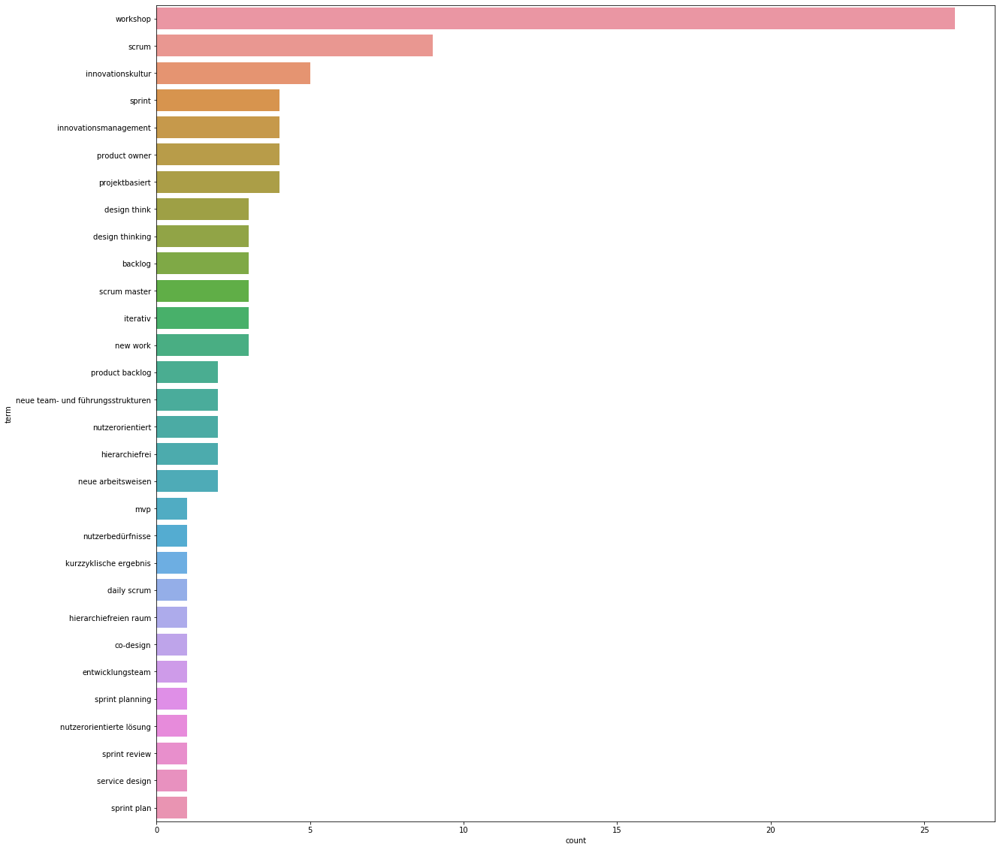

In [20]:
# plotting the co_occurence term frequency for Germany

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Germany/Combined_cleaned.csv")

dict_count = {}

for term in searchterms_de_eng_lemma:
    dict_count[term.lower()] = len(df[df['co_searchterms_matches'].str.contains(term.lower(), flags = re.IGNORECASE)])
print(dict_count)

df_count = pd.DataFrame(dict_count.items(), columns = ["term", "count"])
df_count.sort_values(by="count", inplace=True, ascending=False)
df_count = df_count[df_count['count'] != 0]
plt.figure(figsize=(20,20))
sns.barplot(data=df_count, x="count", y="term", orient="h")


{'" agile " capability': 0, '" agile " ceremony': 0, '" agile " certificate': 0, '" agile " certification': 0, '" agile " coach': 0, '" agile " delivery': 0, '" agile " development': 0, '" agile " digital capability': 0, '" agile " environment': 0, '" agile " innovation': 0, '" agile " management': 0, '" agile " manifesto': 0, '" agile " method': 0, '" agile " methodology': 0, '" agile " mindset': 0, '" agile " operate model': 0, '" agile " organisation': 0, '" agile " organization unit': 0, '" agile " principle': 0, '" agile " process': 0, '" agile " programme': 0, '" agile " project': 0, '" agile " project management': 0, '" agile " software development': 0, '" agile " stage': 0, '" agile " structure': 0, '" agile " team': 0, '" agile " technique': 0, '" agile " transformation': 0, '" agile " transition': 0, '" agile " value': 0, '" agile " wall': 0, '" agile " way': 0, '" agile " way of work': 0, '" agile " work': 1, '" agile " work practice': 0, '" agile " work and management metho

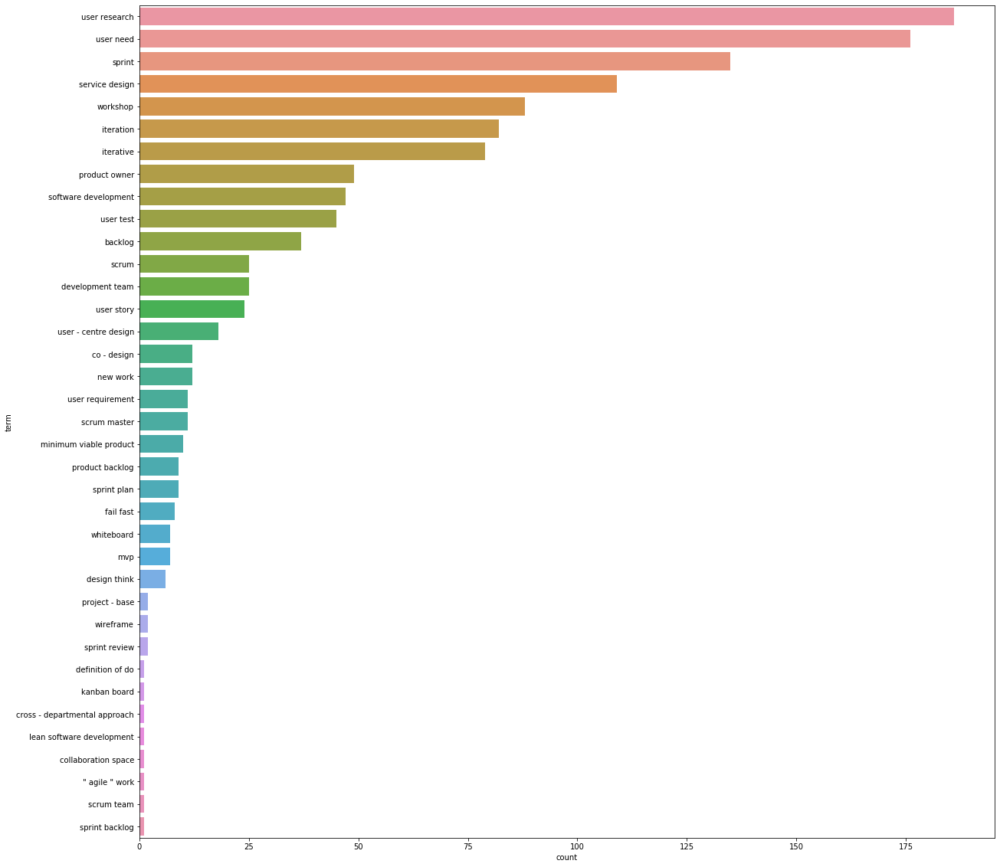

In [19]:
# plotting the co_occurence term frequency for the UK

df = pd.read_csv('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/UK/General_cleaned_org.csv')

dict_count = {}

for term in searchterms_eng_lemma:
    dict_count[term.lower()] = len(df[df['co_searchterms_matches'].str.contains(term.lower(), flags = re.IGNORECASE)])
print(dict_count)

df_count = pd.DataFrame(dict_count.items(), columns = ["term", "count"])
df_count.sort_values(by="count", inplace=True, ascending=False)
df_count = df_count[df_count['count'] != 0]
plt.figure(figsize=(20,20))
sns.barplot(data=df_count, x="count", y="term", orient="h")

In [ ]:
# Testing for Visualisation

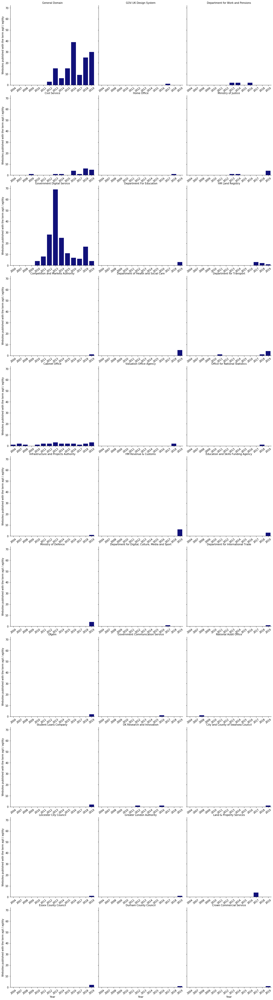

In [10]:
#Plotting UK
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/UK/General_cleaned_org.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df2 = df.groupby(["Year"]).count()
df2.reset_index(inplace=True)
# g = sns.FacetGrid(df,col="Organisation", col_wrap=3)
# g.map(sns.factorplot,'Year')
plot = sns.catplot(x='Year', kind='count', data=df, col='Organisation', col_wrap=3, sharex=False, sharey=True, color='darkblue')
plot.set_xticklabels(rotation=35)
plot.set_ylabels(label="Websites published with the term agil / agility")
plot.set_titles("{col_name}")

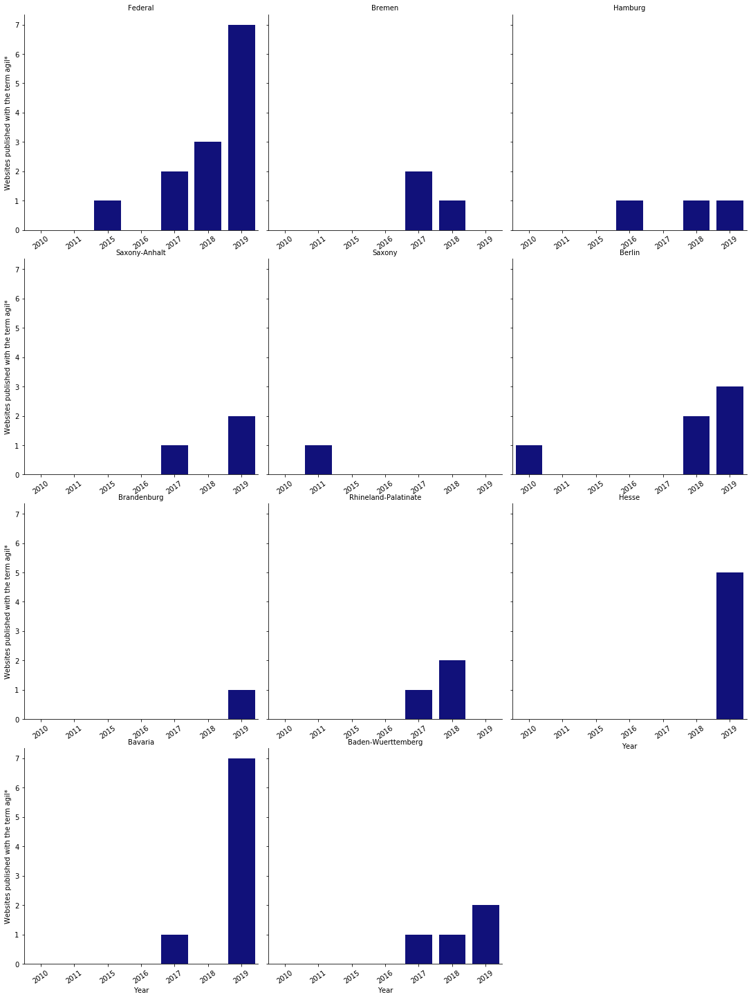

In [7]:
#Plotting per State Germany

inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Germany/Combined_cleaned.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df2 = df.groupby(["Year"]).count()
df2.reset_index(inplace=True)
plot = sns.catplot(x='Year', kind='count', data=df, col='level', col_wrap=3, sharex=False, sharey=True, color='darkblue')
plot.set_xticklabels(rotation=35)
plot.set_ylabels(label="Websites published with the term agil*")
plot.set_titles("{col_name}")

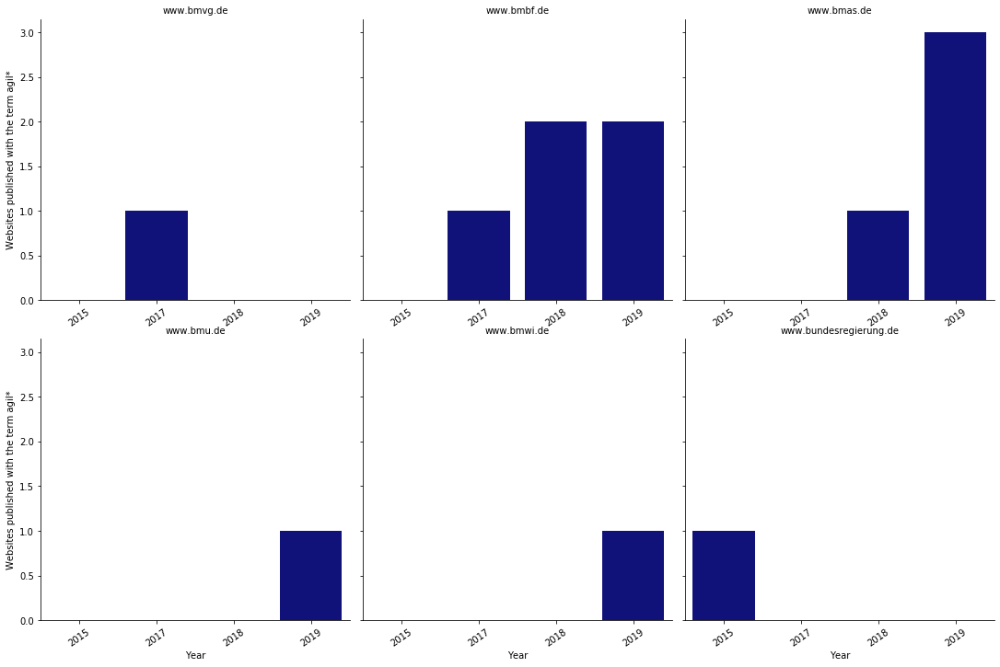

In [6]:
#Printing only Federal Level Ministries Geramany
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Germany/Combined_cleaned.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df = df[df['level'] == 'Federal']
df['Year'] = df['final_date'].dt.year
df2 = df.groupby(["Year"]).count()
df2.reset_index(inplace=True)
plot = sns.catplot(x='Year', kind='count', data=df, col='domain', col_wrap=3, sharex=False, sharey=True, color='darkblue')
plot.set_xticklabels(rotation=35)
plot.set_ylabels(label="Websites published with the term agil*")
plot.set_titles("{col_name}")

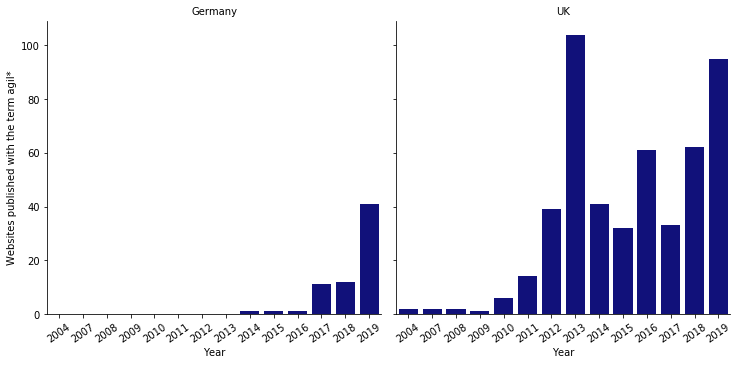

In [25]:
###### Comparing UK and Germany
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df2 = df.groupby(["Year"]).count()
df2.reset_index(inplace=True)
plot = sns.catplot(x='Year', kind='count', data=df, col='country', col_wrap=3, sharex=False, sharey=True, color='darkblue')
plot.set_xticklabels(rotation=35)
plot.set_ylabels(label="Websites published with the term agil*")
plot.set_titles("{col_name}")



In [ ]:
state_list = ["Schleswig-Holstein", "Bremen", "Hamburg", "Lower Saxony", "Thuringia", "Saxony-Anhalt", "Saxony", "Mecklenburg-Vorpommern", "Berlin", "Brandenburg", "North Rhine-Westphalia", "Rhineland-Palatinate", "Saarland", "Hesse", "Bavaria", "Baden-Wuerttemberg"]

In [16]:
# calculating individual German statate's "agile readiness index"

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Germany/Combined_cleaned.csv")

df = df[df.level != "Federal"]

state_list = ["Schleswig-Holstein", "Bremen", "Hamburg", "Lower Saxony", "Thuringia", "Saxony-Anhalt", "Saxony", "Mecklenburg-Vorpommern", "Berlin", "Brandenburg", "North Rhine-Westphalia", "Rhineland-Palatinate", "Saarland", "Hesse", "Bavaria", "Baden-Wuerttemberg"]

df_counts = df.groupby(["level"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for state in state_list:
    if state not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [state], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])
df_counts['agile_breadth'] = (df_counts['total_count']/df_counts['total_count'].max())*100


df_co_terms = df.groupby(['level']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for state in state_list:
    if state not in df_co_terms.index:
        row_df = pd.DataFrame([[0]], index = [state], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])
df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']

df3['agile_depth'] = (df3['agile_depth_absolute'] / df3['agile_depth_absolute'].max())*100


df3['agile_readiness_index_absolute'] = df3['agile_depth'] + df3['agile_breadth']

df3['agile_readiness_index'] = (df3['agile_readiness_index_absolute'] / df3['agile_readiness_index_absolute'].max()) * 100

df3['agile_readiness_index'].fillna(0, inplace=True)

df3 = df3.rename(index={'Baden-Wuerttemberg': 'Baden-Württemberg'})

In [17]:
# plotting Germany Federal levels on map

# set the filepath and load in a shapefile
fp = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Igismap/Germany_Polygon.shp"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe
map_df

,id,country,name,enname,locname,offname,boundary,adminlevel,wikidata,wikimedia,timestamp,note,path,rpath,iso3166_2,geometry
0,62611,DEU,Baden-Württemberg,Baden-Württemberg,Baden-Württemberg,None,administrative,4,Q985,de:Baden-Württemberg,2020-01-02 22:59:02,None,"0,51477,62611","62611,51477,0",DE-BW,"MULTIPOLYGON (((9.00473 47.72174, 9.00474 47.7..."
1,2145268,DEU,Bavaria,Bavaria,Bayern,Freistaat Bayern,administrative,4,Q980,de:Bayern,2020-01-02 22:59:02,None,"0,51477,2145268","2145268,51477,0",DE-BY,"POLYGON ((9.60219 47.58436, 9.60222 47.58437, ..."
2,62422,DEU,Berlin,Berlin,Berlin,Stadtstaat Berlin,administrative,4,Q64,de:Berlin,2020-01-01 22:53:02,None,"0,51477,62422","62422,51477,0",DE-BE,"MULTIPOLYGON (((13.08835 52.41963, 13.09584 52..."
3,62504,DEU,Brandenburg,None,Brandenburg,None,administrative,4,Q1208,de:Brandenburg,2020-01-01 22:53:02,None,"0,51477,62504","62504,51477,0",DE-BB,"MULTIPOLYGON (((11.26623 53.12205, 11.26919 53..."
4,62718,DEU,Bremen,None,Bremen,Freie Hansestadt Bremen,administrative,4,Q1209,de:Freie Hansestadt Bremen,2019-12-21 15:37:02,None,"0,51477,62718","62718,51477,0",DE-HB,"MULTIPOLYGON (((8.73226 53.11396, 8.73352 53.1..."
5,62782,DEU,Hamburg,Hamburg,Hamburg,None,administrative,4,Q1055,de:Hamburg,2019-12-28 22:57:02,None,"0,51477,62782","62782,51477,0",DE-HH,"MULTIPOLYGON (((8.57534 53.84414, 8.57467 53.8..."
6,62650,DEU,Hesse,Hesse,Hessen,None,administrative,4,Q1199,de:Hessen,2019-12-29 22:59:02,None,"0,51477,62650","62650,51477,0",DE-HE,"MULTIPOLYGON (((7.77241 50.05864, 7.77244 50.0..."
7,62771,DEU,Lower Saxony,Lower Saxony,Niedersachsen,None,administrative,4,Q1197,de:Niedersachsen,2020-01-03 22:58:02,None,"0,51477,62771","62771,51477,0",DE-NI,"MULTIPOLYGON (((8.50175 53.20522, 8.50192 53.2..."
8,28322,DEU,Mecklenburg-Vorpommern,Mecklenburg-Vorpommern,Mecklenburg-Vorpommern,None,administrative,4,Q1196,de:Mecklenburg-Vorpommern,2019-12-29 22:59:02,None,"0,51477,28322","28322,51477,0",DE-MV,"MULTIPOLYGON (((14.26382 53.70466, 14.26367 53..."
9,62761,DEU,North Rhine-Westphalia,North Rhine-Westphalia,Nordrhein-Westfalen,None,administrative,4,Q1198,de:Nordrhein-Westfalen,2019-12-27 23:00:01,None,"0,51477,62761","62761,51477,0",DE-NW,"MULTIPOLYGON (((5.86632 51.05110, 5.86637 51.0..."


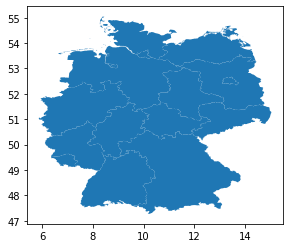

In [18]:
map_df.plot()

In [19]:
merged = map_df.set_index('name').join(df3)
merged.head()

,id,country,enname,locname,offname,boundary,adminlevel,wikidata,wikimedia,timestamp,...,rpath,iso3166_2,geometry,total_count,agile_breadth,total_co_searchterms_nr,agile_depth_absolute,agile_depth,agile_readiness_index_absolute,agile_readiness_index
name,,,,,,,,,,,,,,,,,,,,,
Baden-Württemberg,62611,DEU,Baden-Württemberg,Baden-Württemberg,None,administrative,4,Q985,de:Baden-Württemberg,2020-01-02 22:59:02,...,"62611,51477,0",DE-BW,"MULTIPOLYGON (((9.00473 47.72174, 9.00474 47.7...",4,50.0,6,1.500000,19.565217,69.565217,49.420849
Bavaria,2145268,DEU,Bavaria,Bayern,Freistaat Bayern,administrative,4,Q980,de:Bayern,2020-01-02 22:59:02,...,"2145268,51477,0",DE-BY,"POLYGON ((9.60219 47.58436, 9.60222 47.58437, ...",8,100.0,25,3.125000,40.760870,140.760870,100.000000
Berlin,62422,DEU,Berlin,Berlin,Stadtstaat Berlin,administrative,4,Q64,de:Berlin,2020-01-01 22:53:02,...,"62422,51477,0",DE-BE,"MULTIPOLYGON (((13.08835 52.41963, 13.09584 52...",7,87.5,11,1.571429,20.496894,107.996894,76.723662
Brandenburg,62504,DEU,None,Brandenburg,None,administrative,4,Q1208,de:Brandenburg,2020-01-01 22:53:02,...,"62504,51477,0",DE-BB,"MULTIPOLYGON (((11.26623 53.12205, 11.26919 53...",1,12.5,2,2.000000,26.086957,38.586957,27.413127
Bremen,62718,DEU,None,Bremen,Freie Hansestadt Bremen,administrative,4,Q1209,de:Freie Hansestadt Bremen,2019-12-21 15:37:02,...,"62718,51477,0",DE-HB,"MULTIPOLYGON (((8.73226 53.11396, 8.73352 53.1...",3,37.5,5,1.666667,21.739130,59.239130,42.084942


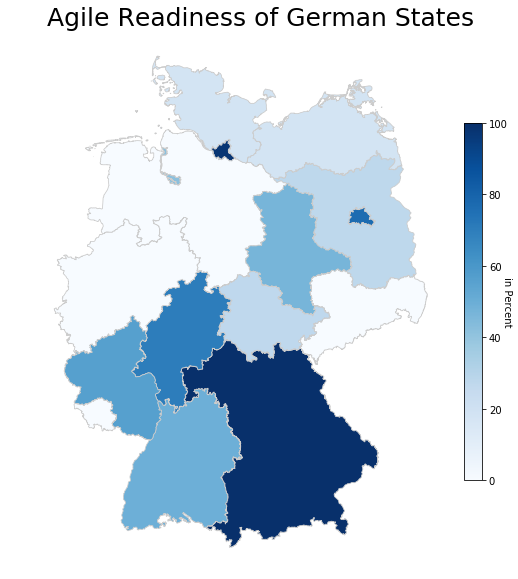

In [134]:
# set a variable that will call whatever column we want to visualise on the map
variable = "agile_readiness_index"
# set the range for the choropleth
vmin, vmax = 0,100
# create figure and axes for Matplotlib
figlength = 5
fig, ax = plt.subplots(1, figsize=(8,20))
# create map
merged.plot(column=variable, cmap="Blues", linewidth=0.8, ax=ax, edgecolor='0.8')
ax.set_aspect(aspect=1.55)
ax.axis("off")
# add a title
ax.set_title('     Agile Readiness of German States', fontdict={'fontsize': '25', 'fontweight' : '3'})
# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm, fraction=0.04, pad=0.04)
cbar.set_label('in Percent', rotation=270)
# saving the figure
fig.savefig('map_export.png', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )


In [124]:
ax